In [1]:
import uproot
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import torch
from scipy import stats
import sklearn
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import cv2
import numpy as np
import PIL
from PIL import Image, ImageChops, ImageDraw
from IPython.display import display
from skimage import io, img_as_float

# Step 1
Load data

In [2]:
with uproot.open('toyForStudents_5.root') as datafile:
    data_df = datafile['R0Tree'].arrays(library='pd')

# Step 2
First data look

In [3]:
df = pd.DataFrame(data_df)
df

,x,y,id,sample
0,3.460569,0.673391,1,1
1,3.075171,0.761314,1,1
2,2.746258,1.339751,1,1
3,2.190463,2.049242,1,1
4,3.988466,0.707543,1,1
...,...,...,...,...
3399995,3.656641,0.730766,-1,17
3399996,5.113425,0.666245,-1,17
3399997,2.826508,1.441562,-1,17
3399998,3.683099,1.125471,-1,17


In [4]:
df_id_minus_1 = df[df['id'] == -1]
df_id_1 = df[df['id'] == 1]

In [5]:
df_id_minus_1

,x,y,id,sample
1700000,3.524324,2.084737,-1,1
1700001,3.497870,1.261757,-1,1
1700002,2.418601,1.440717,-1,1
1700003,3.495933,1.956262,-1,1
1700004,2.284854,2.110827,-1,1
...,...,...,...,...
3399995,3.656641,0.730766,-1,17
3399996,5.113425,0.666245,-1,17
3399997,2.826508,1.441562,-1,17
3399998,3.683099,1.125471,-1,17


In [6]:
df_id_1

,x,y,id,sample
0,3.460569,0.673391,1,1
1,3.075171,0.761314,1,1
2,2.746258,1.339751,1,1
3,2.190463,2.049242,1,1
4,3.988466,0.707543,1,1
...,...,...,...,...
1699995,2.924093,1.452403,1,17
1699996,2.067248,1.737031,1,17
1699997,2.581711,1.004430,1,17
1699998,4.302710,1.388870,1,17


In [7]:
def print_images():
    grouped_minus_1 = df_id_minus_1.groupby('sample')
    grouped_1 = df_id_1.groupby('sample')

    for sample, group_minus_1 in grouped_minus_1:
        group_1 = grouped_1.get_group(sample)

        fig, axs = plt.subplots(1, 2, figsize=(12, 5))

        # DLA id = -1
        axs[0].scatter(group_minus_1['x'], group_minus_1['y'], label='id = -1', color='blue', marker=',', s=1)
        axs[0].set_title(f'Obrazek dla sample {sample} (id = -1)')
        axs[0].set_xlabel('x')
        axs[0].set_ylabel('y')
        axs[0].legend()

        # DLA id = 1
        axs[1].scatter(group_1['x'], group_1['y'], label='id = 1', color='red', marker=",", s=1)
        axs[1].set_title(f'Obrazek dla sample {sample} (id = 1)')
        axs[1].set_xlabel('x')
        axs[1].set_ylabel('y')
        axs[1].legend()

        plt.tight_layout()
        plt.show()


# Step 3
Plots, interpolated

In [8]:
# print_images()

# Step 4
Save cloud points as png files to get exact images

In [9]:
def get_model_training_images(sample):
    data_id_minus_1 = df_id_minus_1[(df_id_minus_1['sample'] == sample) & (df_id_minus_1['id'] == -1)]
    data_id_1 = df_id_1[(df_id_1['sample'] == sample) & (df_id_1['id'] == 1)]

    return data_id_minus_1, data_id_1

In [10]:
a, b = get_model_training_images(17)

In [11]:
a

,x,y,id,sample
3300000,3.140368,2.036576,-1,17
3300001,3.498585,0.740953,-1,17
3300002,3.234064,1.930019,-1,17
3300003,2.658791,0.798944,-1,17
3300004,3.423107,2.123055,-1,17
...,...,...,...,...
3399995,3.656641,0.730766,-1,17
3399996,5.113425,0.666245,-1,17
3399997,2.826508,1.441562,-1,17
3399998,3.683099,1.125471,-1,17


In [12]:
b

,x,y,id,sample
1600000,4.465685,0.796268,1,17
1600001,4.763283,0.922533,1,17
1600002,2.679387,1.167562,1,17
1600003,3.276646,1.320163,1,17
1600004,3.004393,1.491962,1,17
...,...,...,...,...
1699995,2.924093,1.452403,1,17
1699996,2.067248,1.737031,1,17
1699997,2.581711,1.004430,1,17
1699998,4.302710,1.388870,1,17


In [13]:
# def save_point_cloud_as_image(dataframe, filename):
#     width = 500
#     height = 500

#     min_x = dataframe['x'].min()
#     max_x = dataframe['x'].max()
#     min_y = dataframe['y'].min()
#     max_y = dataframe['y'].max()

#     image = Image.new("RGB", (width, height), "white")
#     draw = ImageDraw.Draw(image)

#     for _, row in dataframe.iterrows():
#         x = int((row['x'] - min_x) / (max_x - min_x) * width)
#         y = int((row['y'] - min_y) / (max_y - min_y) * height)
#         draw.point((x, y), fill="black")

#     image.save(filename)

def save_point_cloud_as_image(dataframe, filename):
    width = 6000
    height = 6000
    padding = 5

    min_x = dataframe['x'].min()
    max_x = dataframe['x'].max()
    min_y = dataframe['y'].min()
    max_y = dataframe['y'].max()
    
    x_scale = (width - 2 * padding) / (max_x - min_x)
    y_scale = (height - 2 * padding) / (max_y - min_y)

    image = Image.new("RGB", (width, height), "white")
    draw = ImageDraw.Draw(image)

    for _, row in dataframe.iterrows():
        x = int((row['x'] - min_x) * x_scale) + padding
        y = int((row['y'] - min_y) * y_scale) + padding
        draw.point((x, height - y - 1), fill="black")  # Invert y to match image coordinates

    image.save(filename)


In [14]:
for i in range(1, 2, 1):
    print(f"========== SAMPLE {i} ==========")
    img_minus, img = get_model_training_images(i)
    save_point_cloud_as_image(img_minus, f"cloud_points_to_images_minus/img_minus_{i}.png")
    save_point_cloud_as_image(img, f"cloud_points_to_images/img_{i}.png")
    print(f"Sample {i} saved to cloud_points_to_images/ folder.")
print(f"================================")
print("Conversion done.")

========== SAMPLE 1 ==========
Sample 1 saved to cloud_points_to_images/ folder.
Conversion done.


# Step 5
Cluster analysis
https://scikit-learn.org/stable/modules/clustering.html

## PIL library

In [15]:
def PIL_diff(img1, img2):
    diff = ImageChops.difference(img1, img2)
    if diff.getbbox():
        # yellow_bg = Image.new("RGB", diff.size, "yellow")
        # result = ImageChops.add(yellow_bg, diff)
        # display(result)
        display(diff)
    else:
        print("No differences")

In [16]:
def load_image_from_folder(folder, filename):
    path = f"{folder}/{filename}"
    return Image.open(path)

img_minus_1_loaded = load_image_from_folder("cloud_points_to_images_minus", "img_minus_1.png")
img_1_loaded = load_image_from_folder("cloud_points_to_images", "img_1.png")

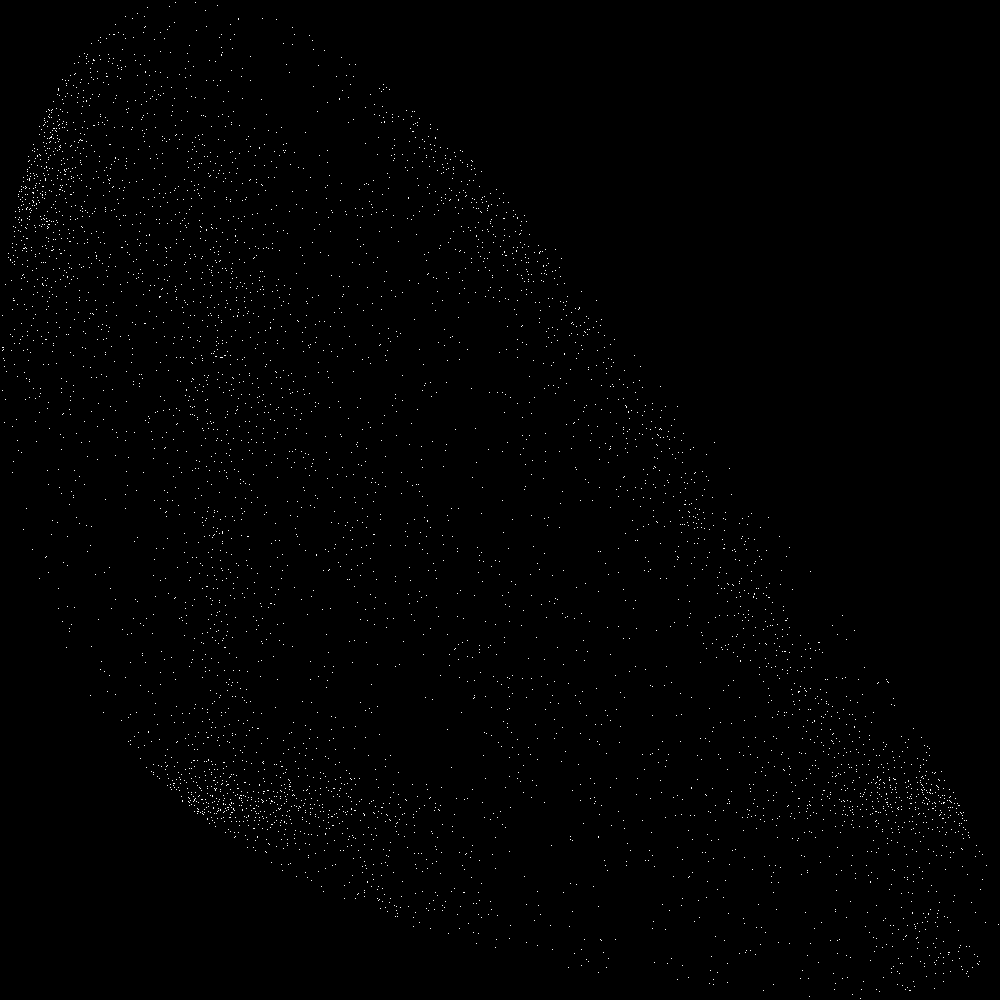

In [17]:
PIL_diff(img_minus_1_loaded, img_1_loaded)

## TESTS FOR PILL LIB METHOD DIFF

In [18]:
x_coordinates = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 15, 25, 35]
y_coordinates = [5, 15, 25, 35, 45, 55, 65, 75, 85, 95, 15, 25, 35]

df1 = pd.DataFrame({
    'x': x_coordinates,
    'y': y_coordinates,
    'id': 1,
    'sample': 1
})

x_coordinates = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 55, 65, 75]
y_coordinates = [5, 15, 25, 35, 45, 55, 65, 75, 85, 95, 55, 65, 75]

df2 = pd.DataFrame({
    'x': x_coordinates,
    'y': y_coordinates,
    'id': -1,
    'sample': -1
})

df_test = pd.concat([df1, df2], ignore_index=True)
#df

In [19]:
df_id_minus_1_test = df_test[df_test['id'] == -1]
df_id_1_test = df_test[df_test['id'] == 1]


In [20]:
def print_images2():

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # DLA id = -1
    axs[0].scatter(df_id_minus_1_test['x'], df_id_minus_1_test['y'], label='id = -1', color='blue', marker=',', s=10)
    axs[0].set_title(f'Obrazek dla sample (id = -1)')
    axs[0].set_xlabel('x')
    axs[0].set_ylabel('y')
    axs[0].legend()

    # DLA id = 1
    axs[1].scatter(df_id_1_test['x'], df_id_1_test['y'], label='id = 1', color='red', marker=",", s=10)
    axs[1].set_title(f'Obrazek dla sample (id = 1)')
    axs[1].set_xlabel('x')
    axs[1].set_ylabel('y')
    axs[1].legend()

    plt.tight_layout()
    plt.show()


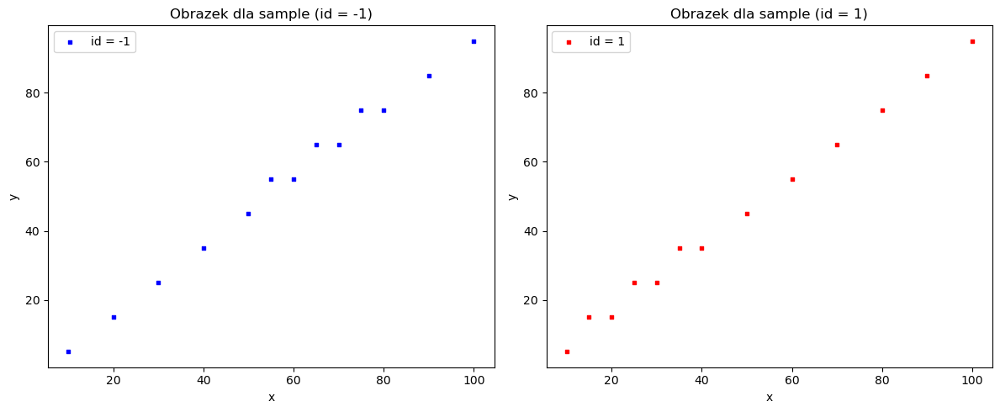

In [21]:
print_images2()

In [22]:
def get_model_training_images():
    data_id_minus_1 = df_id_minus_1_test[(df_id_minus_1_test['sample']) & (df_id_minus_1_test['id'] == -1)]
    data_id_1 = df_id_1_test[(df_id_1_test['sample']) & (df_id_1_test['id'] == 1)]

    return data_id_minus_1, data_id_1

img_minus, img = get_model_training_images()
save_point_cloud_as_image(img_minus, f"test/img_minus_1.png")
save_point_cloud_as_image(img, f"test/img_1.png")
print(f"================================")
print("Conversion done.")


save_point_cloud_as_image(img_minus, f"test/img_minus_1.png")
save_point_cloud_as_image(img, f"test/img_1.png")


Conversion done.


In [23]:
img_test_minus_1 = load_image_from_folder("test", "img_minus_1.png")
img_test_1 = load_image_from_folder("test", "img_1.png")

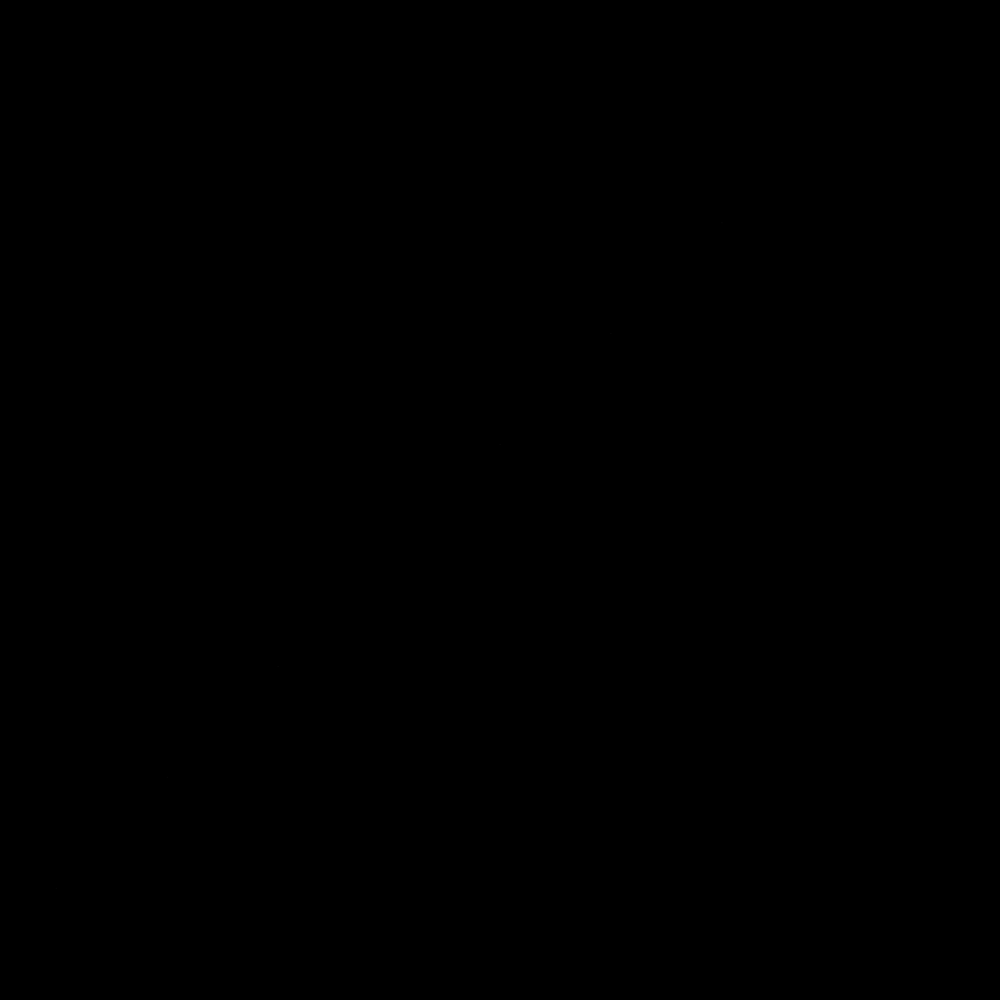

In [24]:
PIL_diff(img_test_minus_1, img_test_1)

In [25]:
df_id_minus_1 = df[df['id'] == -1]
df_id_minus_1
grouped_minus_1 = df_id_minus_1[df_id_minus_1['sample'] == 1]
grouped_minus_1
# grouped_minus_1 = df_id_minus_1.groupby('sample')
# grouped_minus_1
# grouped_minus_1_s_1 = grouped_minus_1['sample'] == 1
# grouped_minus_1_s_1

,x,y,id,sample
1700000,3.524324,2.084737,-1,1
1700001,3.497870,1.261757,-1,1
1700002,2.418601,1.440717,-1,1
1700003,3.495933,1.956262,-1,1
1700004,2.284854,2.110827,-1,1
...,...,...,...,...
1799995,4.818124,0.807776,-1,1
1799996,4.082955,0.873010,-1,1
1799997,5.049155,0.740994,-1,1
1799998,3.069079,1.227595,-1,1


In [26]:
img = cv2.imread('cloud_points_to_images_minus/img_minus_1.png')
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Przygotuj dane
# points = img_gray.reshape((-1, 1))
# print(points)
threshold = 200  # Próg binaryzacji
points = np.where(img_gray == 0)

# Zapisz współrzędne punktów jako tablicę (x, y)
coordinates = np.column_stack((points[1], points[0]))
df_coordinates = pd.DataFrame(coordinates, columns=['x', 'y'])
# print(df_coordinates)
df_coordinates

,x,y
0,1050,4
1,1165,5
2,1225,5
3,1068,6
4,1184,6
...,...,...
99497,5076,5992
99498,4920,5993
99499,5041,5993
99500,5067,5993


## K-Means

In [27]:
def detect_image_differences(img1, img2, num_clusters=2):
    # img1_array = img_as_float(img1)
    # img2_array = img_as_float(img2)

    # img1_flat = img1_array.reshape((-1, 3))
    # img2_flat = img2_array.reshape((-1, 3))
    # print(img1_flat)

    # load first picture in gray
    img = cv2.imread('cloud_points_to_images_minus/img_minus_1.png')
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # save all black pixels and its location as x y
    points = np.where(img_gray == 0)
    coordinates = np.column_stack((points[1], points[0]))
    df_coordinates = pd.DataFrame(coordinates, columns=['x', 'y'])

    # load second picture in gray
    img2 = cv2.imread('cloud_points_to_images/img_1.png')
    img_gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    # save all black pixels and its location as x y
    points2 = np.where(img_gray2 == 0)
    coordinates2 = np.column_stack((points2[1], points2[0]))
    df_coordinates2 = pd.DataFrame(coordinates2, columns=['x', 'y'])
    # print(df_coordinates)

    
    combined_data = np.vstack((df_coordinates, df_coordinates2))

    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    K = range(1, 15)

    for k in K:
        kmeanModel = KMeans(n_clusters=k).fit(combined_data)
        kmeanModel.fit(combined_data)

        # distortions
        distortions.append(sum(np.min(cdist(combined_data, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / combined_data.shape[0])

        # inertias
        inertias.append(kmeanModel.inertia_)

        mapping1[k] = sum(np.min(cdist(combined_data, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / combined_data.shape[0]
        mapping2[k] = kmeanModel.inertia_

    plt.plot(K, distortions, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Distortion')
    plt.title('The Elbow Method using Distortion')
    plt.show()

    plt.plot(K, inertias, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Inertia')
    plt.title('The Elbow Method using Inertia')
    plt.show()

    num_clusters = num_clusters
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    labels = kmeans.fit_predict(combined_data)

    # add cluster value to each coordinates
    df_coordinates['cluster'] = labels[:len(df_coordinates)]
    df_coordinates2['cluster'] = labels[len(df_coordinates):]

    combined_data_clusters = np.vstack((df_coordinates, df_coordinates2))
    combined_data_clusters = pd.DataFrame(combined_data_clusters, columns=['x', 'y', 'cluster'])
    
    # Konwersja różnic z powrotem na wymiary obrazu
    # differences_img = differences.reshape(img_gray.shape)
    # differences_indices = np.where(labels1 != labels2)[0]
    # differences_coordinates = df_coordinates.iloc[differences_indices]
    # df_coordinates['cluster'] = labels1
    # df_coordinates2['cluster'] = labels2

    # print(df_coordinates)

    # to chyba nie ma sensu
    differences_coordinates = df_coordinates[df_coordinates['cluster'] == df_coordinates['cluster']]
    diff_xy = differences_coordinates[['x', 'y']]

    plt.figure(figsize=(8, 6))
    for cluster in range(num_clusters):
        cluster_points = combined_data_clusters[combined_data_clusters['cluster'] == cluster]
        plt.scatter(cluster_points['x'], cluster_points['y'], label=f'Cluster {cluster}', alpha=0.5, s=1)
    # plt.scatter(differences_coordinates['x'], differences_coordinates['y'], color='red', label='Different Clusters', s=1)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Combined image')
    plt.legend()


    plt.figure(figsize=(8, 6))
    for cluster in range(num_clusters):
        cluster_points = df_coordinates[df_coordinates['cluster'] == cluster]
        plt.scatter(cluster_points['x'], cluster_points['y'], label=f'Cluster {cluster}', alpha=0.5, s=1)
    # plt.scatter(differences_coordinates['x'], differences_coordinates['y'], color='red', label='Different Clusters', s=1)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('First image')
    plt.legend()

    plt.figure(figsize=(8, 6))
    for cluster in range(num_clusters):
        cluster_points = df_coordinates2[df_coordinates2['cluster'] == cluster]
        plt.scatter(cluster_points['x'], cluster_points['y'], label=f'Cluster {cluster}', alpha=0.5, s=1)
    # plt.scatter(differences_coordinates['x'], differences_coordinates['y'], color='red', label='Different Clusters', s=1)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('Second image')
    plt.legend()
    plt.show()

    # print(differences_coordinates)
    return diff_xy

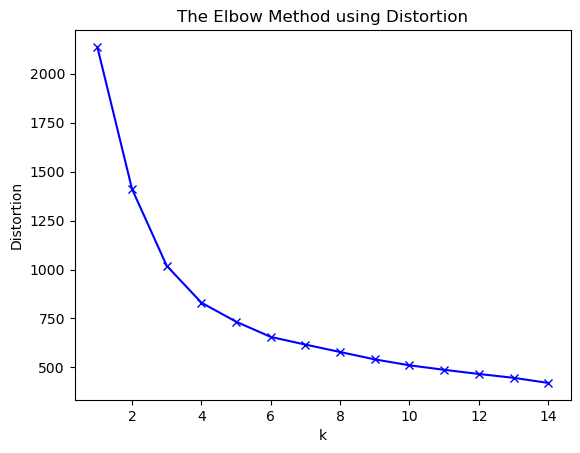

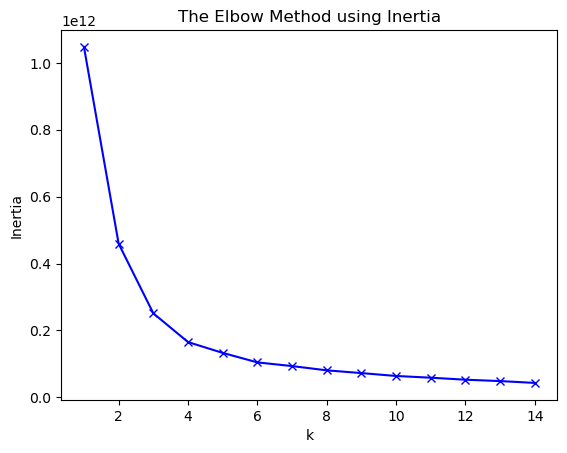

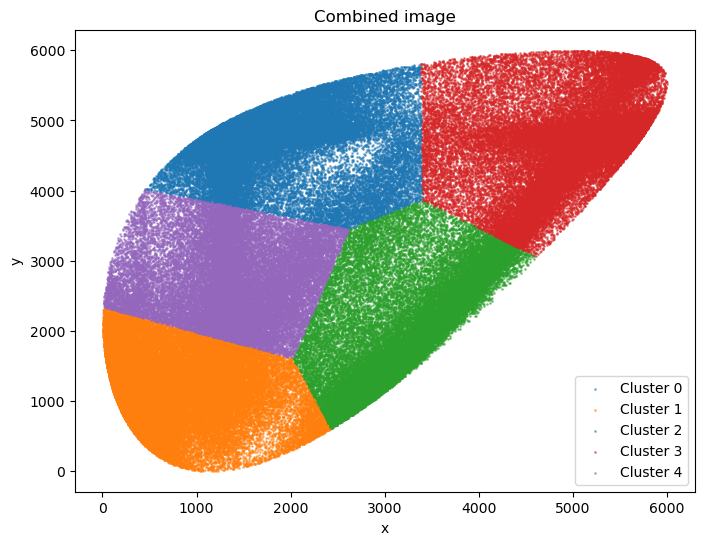

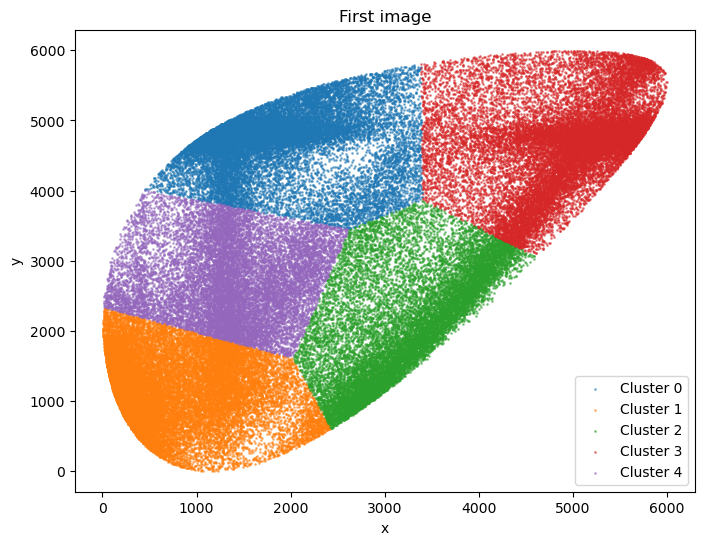

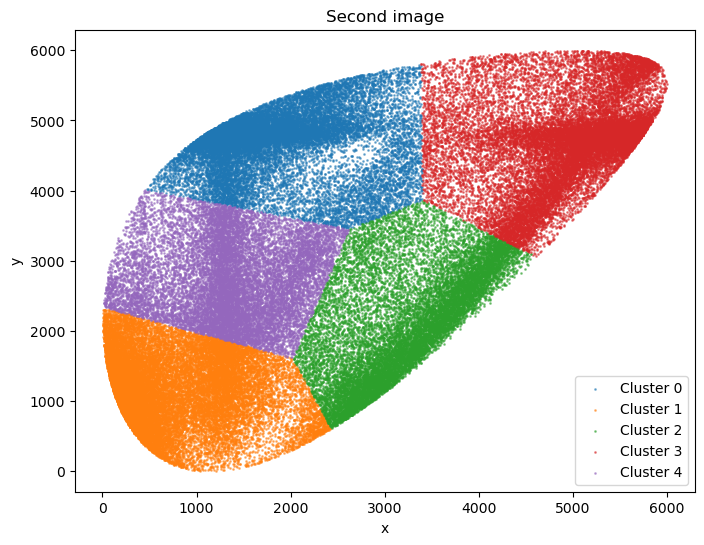

In [28]:
differences_img = detect_image_differences(img_minus_1_loaded, img_1_loaded, 5)

save_point_cloud_as_image(differences_img, "test_differences.png")

# io.imshow(differences_img, cmap='gray')
# io.show()

In [79]:
img = cv2.imread('cloud_points_to_images_minus/img_minus_1.png')
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# save all black pixels and its location as x y
points = np.where(img_gray == 0)
coordinates = np.column_stack((points[1], points[0]))
df_coordinates = pd.DataFrame(coordinates, columns=['x', 'y'])

# load second picture in gray
img2 = cv2.imread('cloud_points_to_images/img_1.png')
img_gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# save all black pixels and its location as x y
points2 = np.where(img_gray2 == 0)
coordinates2 = np.column_stack((points2[1], points2[0]))
df_coordinates2 = pd.DataFrame(coordinates2, columns=['x', 'y'])
# print(df_coordinates)

combined_data = np.vstack((df_coordinates, df_coordinates2))

num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
labels = kmeans.fit_predict(combined_data)

# add cluster value to each coordinates
df_coordinates['cluster'] = labels[:len(df_coordinates)]
df_coordinates2['cluster'] = labels[len(df_coordinates):]

combined_data_clusters = np.vstack((df_coordinates, df_coordinates2))
combined_data_clusters = pd.DataFrame(combined_data_clusters, columns=['x', 'y', 'cluster'])



cluster_counts_df1 = df_coordinates.groupby('cluster').size().rename('size_df1')
cluster_counts_df2 = df_coordinates2.groupby('cluster').size().rename('size_df2')

cluster_comparison = pd.merge(cluster_counts_df1, cluster_counts_df2, how='outer', left_index=True, right_index=True)

cluster_comparison['p_df1'] = cluster_comparison['size_df1'] / cluster_comparison['size_df1'].sum()
cluster_comparison['p_df2'] = cluster_comparison['size_df2'] / cluster_comparison['size_df2'].sum()

cluster_comparison['df1_to_df2'] = cluster_comparison['size_df1'] / cluster_comparison['size_df2']

print(cluster_comparison)
print()



from scipy.stats import chi2_contingency


observed = cluster_comparison[['size_df1', 'size_df2']].values

density_comparison = cluster_comparison['size_df1'] / cluster_comparison['size_df2']

chi2, p, dof, expected = chi2_contingency(observed)

print("Wartość statystyki chi-kwadrat:", chi2)
print("Wartość p:", p)
print("Stopnie swobody:", dof)
print("Oczekiwane wartości:", expected)
# print("Porównanie wartości gęstości punktów w klastrach df_coordinates do df_coordinates2:")
# density_comparison



# chi-kwadrat (chi2) informuje o sile różnic między obserwowanymi a oczekiwanymi wartościami
# niska wartość p ( <0,05) oznacza, że różnice są istotne
# ozekiwane częstości (expected) to wartości, które zostałyby otrzymane, gdyby obserwowane wartości były zgodne z rozkładem spodziewanym


         size_df1  size_df2     p_df1     p_df2  df1_to_df2
cluster                                                    
0           21725     21094  0.218337  0.211966    1.029914
1           24382     24847  0.245040  0.249678    0.981285
2           15480     15954  0.155575  0.160316    0.970290
3           22619     22038  0.227322  0.221452    1.026364
4           15296     15583  0.153726  0.156588    0.981582

Wartość statystyki chi-kwadrat: 31.0639378899524
Wartość p: 2.9708188775429034e-06
Stopnie swobody: 4
Oczekiwane wartości: [[21407.99394025 21411.00605975]
 [24612.76848325 24616.23151675]
 [15715.89438141 15718.10561859]
 [22326.92929283 22330.07070717]
 [15438.41390226 15440.58609774]]


In [71]:

from scipy.stats import chi2_contingency
from scipy.stats import ttest_ind

expected_density_comparison = cluster_comparison['size_df1'].sum() / cluster_comparison['size_df2'].sum()

# print("\n\n", expected_density_comparison, "\n\n")

density_comparison_array = np.array(density_comparison)

observed_array = np.array([density_comparison_array, [expected_density_comparison] * len(density_comparison)])

print("\n", density_comparison_array, "\n")

print("\n", observed_array, "\n")

chi2_density, p_density, _, expected_density = chi2_contingency(observed_array)

print("Wartość statystyki chi-kwadrat dla porównania gęstości punktów w klastrach:")
print(chi2_density)
print("Wartość p dla porównania gęstości punktów w klastrach:")
print(p_density)
print("Oczekiwane gęstości do klastrów:", expected_density)
print(expected_density)


# Pierwszy wiersz expected_density zawiera oczekiwane gęstości punktów dla każdego klastra, zakładając, że gęstość punktów jest równomierna między klastrami
# Drugi wiersz expected_density zawiera oczekiwane gęstości punktów, które zostały znormalizowane, aby suma gęstości w każdym klastrze wynosiła 1


# Test t-studenta
t_statistic, p_value = ttest_ind(density_comparison, [expected_density_comparison]*len(density_comparison))

print("Wartość statystyki t dla porównania gęstości punktów w klastrach:")
print(t_statistic)
print("Wartość p dla porównania gęstości punktów w klastrach:")
print(p_value)


# t określa różnicę między średnimi gęstościami punktów w klastrach dla obu zbiorów danych. 
# Im większa wartość t, tym większe są różnice między grupami. Wartość t bliska zeru sugeruje, że nie ma istotnych różnic między gęstościami punktów

# małe wartości p sugerują, że różnice między grupami są istotne statystycznie, podczas gdy wysokie wartości p sugerują, że różnice nie są istotne



 [1.02991372 0.98128547 0.97028958 1.02636355 0.98158249] 


 [[1.02991372 0.98128547 0.97028958 1.02636355 0.98158249]
 [0.99985932 0.99985932 0.99985932 0.99985932 0.99985932]] 

Wartość statystyki chi-kwadrat dla porównania gęstości punktów w klastrach:
0.0015684954691832882
Wartość p dla porównania gęstości punktów w klastrach:
0.9999996926384805
Oczekiwane gęstości do klastrów: [[1.01388453 0.98959441 0.9841019  1.0121112  0.98974278]
 [1.01588851 0.99155038 0.98604701 1.01411167 0.99169904]]
[[1.01388453 0.98959441 0.9841019  1.0121112  0.98974278]
 [1.01588851 0.99155038 0.98604701 1.01411167 0.99169904]]
Wartość statystyki t dla porównania gęstości punktów w klastrach:
-0.15741889284437902
Wartość p dla porównania gęstości punktów w klastrach:
0.8788153443910907


In [ ]:
def kmeans_image_diff2_change(img1, img2, plot_flag, num_clusters=10):

    img = cv2.imread('cloud_points_to_images_minus/img_minus_1.png')
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # save all black pixels and its location as x y
    points = np.where(img_gray == 0)
    coordinates = np.column_stack((points[1], points[0]))
    df_coordinates = pd.DataFrame(coordinates, columns=['x', 'y'])

    # load second picture in gray
    img2 = cv2.imread('cloud_points_to_images/img_1.png')
    img_gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

    # save all black pixels and its location as x y
    points2 = np.where(img_gray2 == 0)
    coordinates2 = np.column_stack((points2[1], points2[0]))
    df_coordinates2 = pd.DataFrame(coordinates2, columns=['x', 'y'])
    # print(df_coordinates)

    
    combined_data = np.vstack((df_coordinates, df_coordinates2))

    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    K = range(1, 15)

    for k in K:
        kmeanModel = KMeans(n_clusters=k).fit(combined_data)
        kmeanModel.fit(combined_data)

        # distortions
        distortions.append(sum(np.min(cdist(combined_data, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / combined_data.shape[0])

        # inertias
        inertias.append(kmeanModel.inertia_)

        mapping1[k] = sum(np.min(cdist(combined_data, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / combined_data.shape[0]
        mapping2[k] = kmeanModel.inertia_

    plt.plot(K, distortions, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Distortion')
    plt.title('The Elbow Method using Distortion')
    plt.show()

    plt.plot(K, inertias, 'bx-')
    plt.xlabel('k')
    plt.ylabel('Inertia')
    plt.title('The Elbow Method using Inertia')
    plt.show()

    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(combined_data)

    labels = kmeans.labels_

    img1_labels = labels[:len(df_coordinates)]
    img2_labels = labels[len(df_coordinates):]

    height, width = 6000, 6000

    diff_img = Image.new('RGB', (width, height), (255, 255, 255))
    diff_pixels = diff_img.load()
    diff_img_gray = Image.new('RGB', (width, height), (255, 255, 255))
    diff_pixels_gray = diff_img_gray.load()

    for i in range(len(img1_labels)):
        if img1_labels[i] != img2_labels[i]:
            x = i % width
            y = i // width
            diff_pixels_gray[x, y] = (0, 0, 0)  # Czarny - róznice z img_1 i img_2
            if img1_labels[i] == 0:
                diff_pixels[x, y] = (255, 0, 0)  # Czerwony - piksel występuje tylko w img_2
            else:
                diff_pixels[x, y] = (0, 0, 255)  # Niebieski - piksel występuje tylko w img_1

    return diff_img, diff_img_gray, optimal_num_clusters

In [31]:
def kmeans_image_diff(img1, img2, plot_flag, num_clusters=10):
    img1_array = np.array(img1)
    img2_array = np.array(img2)

    img1_flat = img1_array.reshape((-1, 3))
    img2_flat = img2_array.reshape((-1, 3))

    combined_data = np.vstack((img1_flat, img2_flat))

    distortions = []
    for i in range(1, num_clusters + 1):
        kmeans = KMeans(n_clusters=i)
        kmeans.fit(img1_flat) # combined_data ???
        distortions.append(kmeans.inertia_)

    optimal_num_clusters = 1
    for i in range(1, num_clusters - 1):
        if (distortions[i] - distortions[i + 1]) / distortions[i] < 0.05:
            optimal_num_clusters = i + 1
            break
    if plot_flag == True:
        plt.figure(figsize=(10, 5))
        plt.plot(range(1, num_clusters + 1), distortions, marker='o')
        plt.xlabel('Number of clusters')
        plt.ylabel('Distortion')
        plt.title('Elbow Method')
        # plt.xticks(range(1, num_clusters + 1))
        # plt.grid(True)
        plt.show()

    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(combined_data)

    labels = kmeans.labels_

    img1_labels = labels[:img1_flat.shape[0]]
    img2_labels = labels[img1_flat.shape[0]:]

    height, width, _ = img1_array.shape

    diff_img = Image.new('RGB', (width, height), (255, 255, 255))
    diff_pixels = diff_img.load()
    diff_img_gray = Image.new('RGB', (width, height), (255, 255, 255))
    diff_pixels_gray = diff_img_gray.load()

    for i in range(len(img1_labels)):
        if img1_labels[i] != img2_labels[i]:
            x = i % width
            y = i // width
            diff_pixels_gray[x, y] = (0, 0, 0)  # Czarny - róznice z img_1 i img_2
            if img1_labels[i] == 0:
                diff_pixels[x, y] = (255, 0, 0)  # Czerwony - piksel występuje tylko w img_2
            else:
                diff_pixels[x, y] = (0, 0, 255)  # Niebieski - piksel występuje tylko w img_1

    return diff_img, diff_img_gray, optimal_num_clusters

c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (3). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\mic

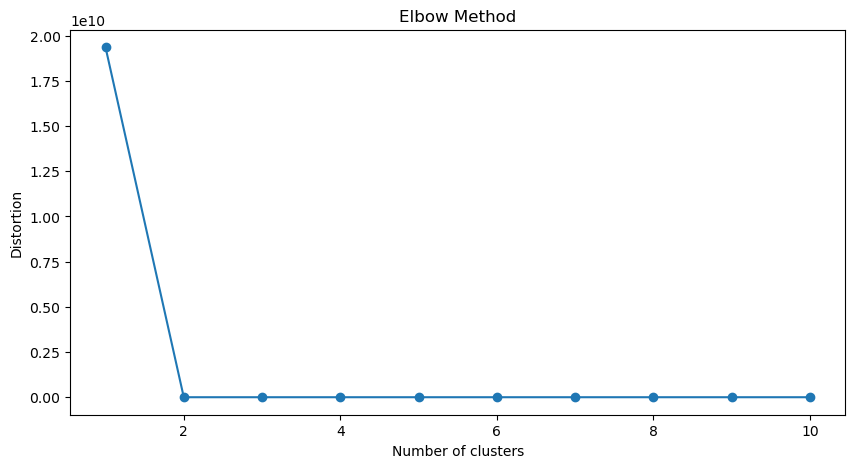

c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


Optimal number of clusters = 2


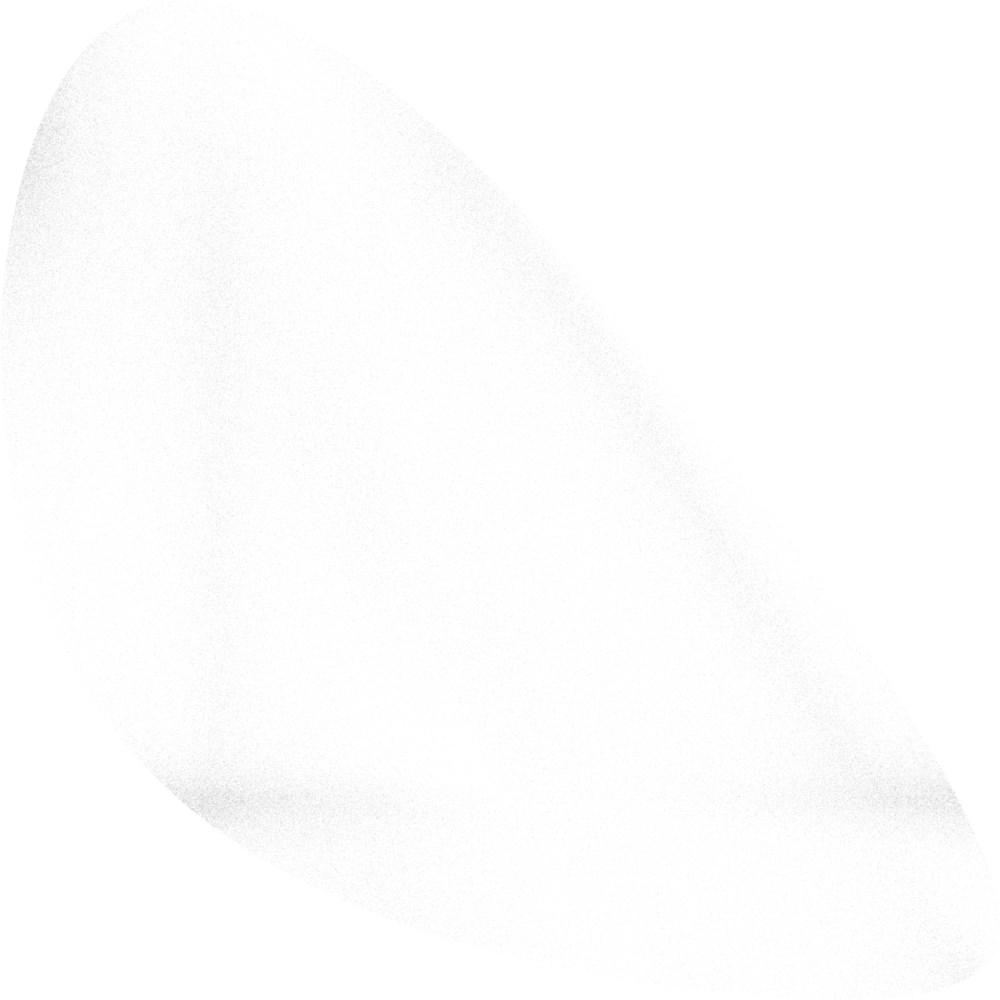

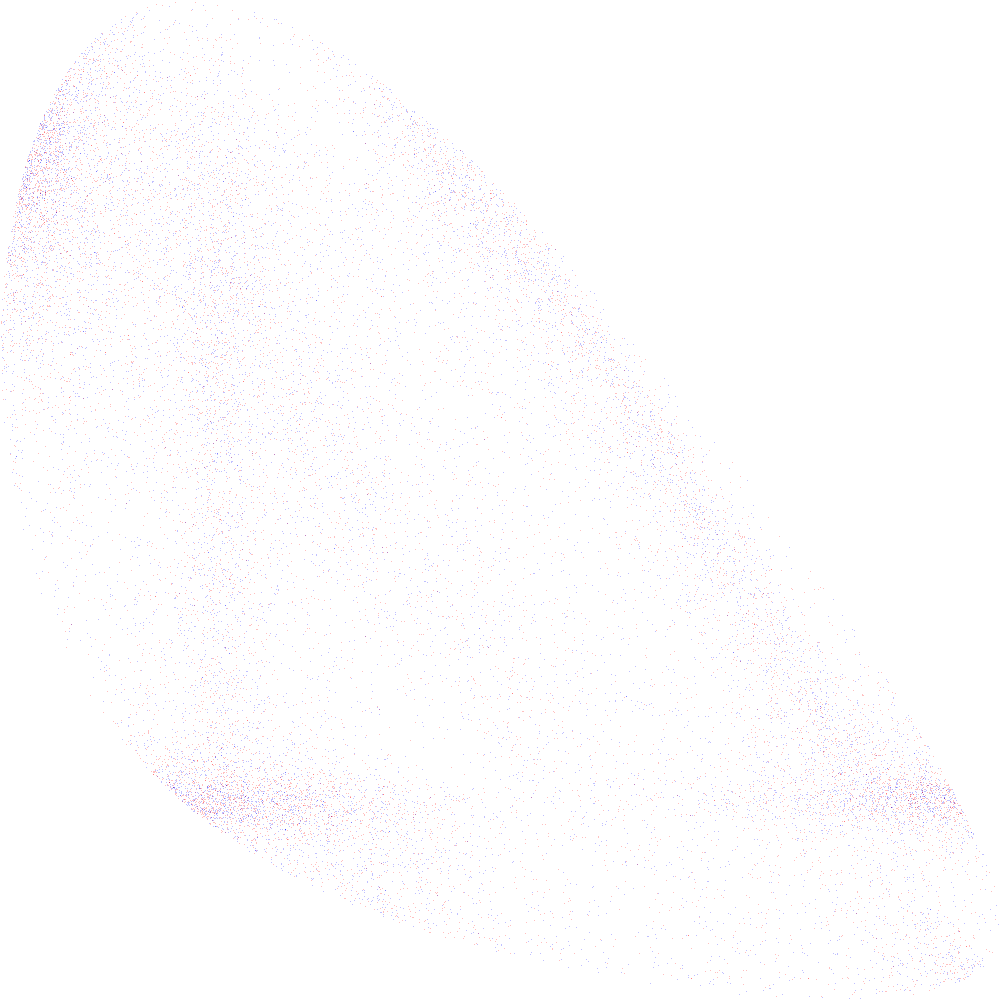

In [32]:
differences_image, differences_image_gray, optimal_num_clusters = kmeans_image_diff(img1=img_1_loaded, img2=img_minus_1_loaded, plot_flag=True, num_clusters=10)
print(f"Optimal number of clusters = {optimal_num_clusters}")
display(differences_image_gray)
display(differences_image)

In [ ]:
def t_test(img1, img2, num_clusters=10):
    _, _, distortions_img1 = kmeans_image_diff(img1=img_1_loaded, img2=img_minus_1_loaded, plot_flag=False, num_clusters=10)
    _, _, distortions_img2 = kmeans_image_diff(img1=img_1_loaded, img2=img_minus_1_loaded, plot_flag=False, num_clusters=10)  # dla drugiego obrazu używamy tego samego

    t_statistic, p_value = stats.ttest_ind(distortions_img1, distortions_img2, equal_var=False)

    return t_statistic, p_value

t_stat, p_val = t_test(img_1_loaded, img_minus_1_loaded)
print("Statystyka t:", t_stat)
print("Wartość p:", p_val)


c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (3). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\sklearn\base.py:1474: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)
c:\Users\mic

Statystyka t: nan
Wartość p: nan


c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\scipy\stats\_stats_py.py:1087: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
c:\Users\micha\anaconda3\envs\ml\Lib\site-packages\scipy\stats\_stats_py.py:1087: RuntimeWarning: invalid value encountered in scalar multiply
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [ ]:

Aby wykonać test t-Studenta na podstawie wyników z funkcji kmeans_image_diff, najpierw należy zdefiniować zmienną losową, którą chcemy porównać pomiędzy dwoma grupami. W tym przypadku moglibyśmy rozważyć średnią wartość dystorsji (distortion) dla każdego obrazu jako taką zmienną. Następnie, używając wyników obliczeń dla obu obrazów, można przeprowadzić test t-Studenta, aby sprawdzić, czy istnieją istotne różnice między średnimi wartościami dystorsji dla tych dwóch obrazów.

SyntaxError: invalid syntax (2421769390.py, line 1)